# Calibration error estimates
### David Widmann

# Intro

In the following experiments we compute calibration error estimates of the model
```math
\begin{aligned}
   g(X) &\sim \textrm{Dir}(\alpha),\\
   Z &\sim \textrm{Ber}(\pi),\\
   Y \,|\, g(X) = \gamma, Z = 1 &\sim \textrm{Categorical}(\beta),\\
   Y \,|\, g(X) = \gamma, Z = 0 &\sim \textrm{Categorical}(\gamma),
\end{aligned}
```
where $\alpha \in \mathbb{R}_{>0}^m$ determines the distribution of predictions
$g(X)$, $\pi > 0$ determines the degree of miscalibration, and $\beta$ defines
a fixed categorical distribution.

In our experiments we consider the two choices
$\alpha = (1,\ldots,1)$, corresponding to a uniform distribution of predictions,
and $\alpha = (0.1, \ldots, 0.1)$, mimicking a distribution after training that
is pushed towards the edges of the probability simplex. Moreover, we fix $\beta$
to $(1/m, \ldots, 1/m)$ and $(1, 0, \ldots, 0)$.

For the chosen parameters $\alpha = (a, \ldots, a)$ with $a = 1$ or $a = 0.1$
in our experiments, the analytic expected calibration error of the model is
```math
\mathbb{E}[\|.\|_{\mathrm{TV}},g] = \frac{\pi}{a B(a, (m-1) a)} {\left(\frac{{(m-1)}^{m-1}}{m^m}\right)}^a,
```
if $\beta = (1/m, \ldots, 1/m)$, and
```math
\mathbb{E}[\|.\|_{\mathrm{TV}},g] = \frac{\pi(m-1)}{m},
```
if $\beta = (1, 0, \ldots, 0)$. In general, the expected calibration error with
respect to the total variation distance is
```math
\mathbb{E}[\|.\|_{\mathrm{TV}},g] =
\pi \sum_{i=1}^m \left(\beta_i I(\beta_i; \alpha_i, \alpha_0 - \alpha_i)
- \frac{\alpha_i}{\alpha_0} I(\beta_i; \alpha_i + 1, \alpha_0 - \alpha_i)\right),
```
where $I(x; a, b) := B(x; a, b) / B(a, b)$ is the regularized incomplete Beta
function.

# Packages

We perform distributed computing to speed up our computations.

In [1]:
using Distributed

First we have to activate the local package environment on all cores.

In [2]:
@everywhere begin
    using Pkg
    Pkg.activate(joinpath(@__DIR__, ".."))
end

Activating environment at `~/Projects/julia/CalibrationPaper/experiments/Project.toml`


Then we load the packages that are required on all cores.

In [3]:
@everywhere begin
    using CalibrationPaper
    using CalibrationErrors
    using Distributions
    using Parameters
    using StatsBase

    using LinearAlgebra
    using Random
end

We perform I/O and save the results as CSV files only on the main process.

In [4]:
using CSV
using DataFrames
using Plots
using ProgressMeter

using Statistics

theme(:wong2)
gr()

Plots.GRBackend()

# Experiments

## Setup

In our experiments we sample a data set of 250 labeled predictions from our generative
model. For this data set we evaluate a calibration error estimator. We repeat the
sampling procedure multiple times to obtain a distribution of estimates.

In [5]:
@everywhere struct Experiment{E,M<:CalibrationPaperModel}
    estimator::E
    model::M
end

@everywhere function Random.rand!(rng::AbstractRNG, experiment::Experiment, estimates, channel)
    @unpack estimator, model = experiment
    @unpack m, π, only_firstclass = model

    # define the samplers of predictions and labels
    prediction_gamma_sampler = sampler(Gamma(model.αᵢ))
    if !only_firstclass
        label_sampler = Random.Sampler(rng, 1:m)
    end

    # define the caches for predictions and labels
    predictions = [Vector{Float64}(undef, m) for _ in 1:250]
    labels = Vector{Int}(undef, 250)

    for i in 1:length(estimates)
        # sample the predictions
        for prediction in predictions
            rand!(rng, prediction_gamma_sampler, prediction)
            ldiv!(sum(prediction), prediction)
        end

        # sample the labels
        @inbounds for j in eachindex(labels)
            if π ≥ 1 || rand(rng) < π
                if only_firstclass
                    labels[j] = 1
                else
                    labels[j] = rand(rng, label_sampler)
                end
            else
                labels[j] = sample(rng, Weights(predictions[j]))
            end
        end

        # evaluate the estimator
        if estimator isa CalibrationErrors.CalibrationErrorEstimator
            @inbounds estimates[i] = calibrationerror(estimator, predictions, labels)
        else
            @inbounds estimates[i] = calibrationerror(estimator(predictions), predictions, labels)
        end

        # update channel
        put!(channel, true)
    end

    estimates
end

We run these experiments 10000 times for $m \in \{2, 10, 100, 1000\}$ classes,
$\alpha_i \in \{0.1, 1\}$, $\pi \in \{0, 0.25, 0.5, 0.75, 1\}$, and
$\beta = (1, 0, \ldots, 0)$ and $\beta = (1/m, \ldots, 1/m)$. The results of each set of
experiments is saved as a CSV file in the subdirectory `data/errors`. To be able to
reproduce our results we set the seed of the random number generator to 1234 before each
run.

In [6]:
function perform(estimator, experiment; n::Int = 10_000)
    # determine output file
    datadir = joinpath(@__DIR__, "..", "data", "errors")
    file = joinpath(datadir, "$experiment.csv")

    # do not overwrite existing files
    if isfile(file)
        @info "skipping experiment $experiment: $file exists"
        return
    end

    # create output directory if it does not exist
    isdir(datadir) || mkpath(datadir)

    # define the investigated models
    models = [CalibrationPaperModel(m, αᵢ, π, only_firstclass) for m in (2, 10, 100, 1000),
              αᵢ in (0.1, 1.0), π in 0:0.25:1, only_firstclass in (true, false)]

    # define the pool of workers, the progress bar, and its update channel
    wp = CachingPool(workers())
    p = Progress(80 * n, 1, "running experiment $experiment...")
    channel = RemoteChannel(() -> Channel{Bool}(80 * n))

    local estimates
    @sync begin
        # update the progress bar
        @async while take!(channel)
            next!(p)
        end

        # compute the calibration error estimates for all models
        estimates = let rng = Random.GLOBAL_RNG, estimator = estimator, n = n, channel = channel
            pmap(wp, models) do model
                # copy random number generator and set seed
                _rng = deepcopy(rng)
                Random.seed!(_rng, 1234)

                # perform experiment
                rand!(_rng, Experiment(estimator(model), model), Vector{Float64}(undef, n),
                      channel)
            end
        end

        # stop progress bar
        put!(channel, false)
    end

    # save estimates
    @info "saving experiment $experiment..."
    open(file, "w") do f
        @inbounds for i in 1:length(models)
            # obtain model
            model = models[i]

            # create data frame
            df = DataFrame(estimate = estimates[i],  m = model.m, αᵢ = model.αᵢ,
                           π = model.π, only_firstclass = model.only_firstclass)

            # save it
            CSV.write(f, df; append = i > 1)
        end
    end

    nothing
end

perform (generic function with 1 method)

## Plotting results

We visualize the distribution of the estimates by histograms. The mean value of the
estimates is indicated by a solid line and the analytic calibration error is visualized
as a dashed line. In the case of the squared kernel calibration error we take the mean
value of the realizations of the unbiased quadratic estimator of the squared kernel
calibration error as approximation of the true value.

In [7]:
@userplot CEGrid

@recipe function f(h::CEGrid)
    # extract experiment
    experiment = h.args[1]

    # extract parameter setting of distributions of predictions and labels
    αᵢ = pop!(plotattributes, :αᵢ)
    only_firstclass = pop!(plotattributes, :only_firstclass)

    # default settings
    layout := (4, 5)
    size --> (1440, 960)
    linewidth --> 2
    xlabel --> "calibration estimate"
    ylabel --> "# runs"
    legend --> false

    # for all studied models
    models = [CalibrationPaperModel(m, αᵢ, π, only_firstclass) for π in 0:0.25:1,
              m in (2, 10, 100, 1000)]

    # add subplots
    file = joinpath(@__DIR__, "..", "data", "errors", "$experiment.csv")
    df = CSV.read(file)

    for (i, model) in enumerate(models)
        # load samples
        estimates = collect_estimates(df, model)

        # compute true value
        if startswith(experiment, "ECE")
            analytic = CalibrationPaper.analytic_ece(model)
        else
            # take mean of quadratic unbiased estimates
            if startswith(experiment, "SKCEuq")
                analytic = mean(estimates)
            else
                file_uq = replace(file, r"(SKCEb|SKCEul)" => "SKCEuq")
                estimates_uq = collect_estimates(CSV.read(file_uq), model)
                analytic = mean(estimates_uq)
            end
        end

        # plot histogram of estimates
        subplot := i
        title := "m = $(model.m), pi = $(model.π)"

        # plot histogram of estimates
        @series begin
            seriestype := :histogram
            estimates
        end

        # indicate mean of estimates
        @series begin
            seriestype := :vline
            [mean(estimates)]
        end

        # indicate analytic calibration error
        if analytic !== nothing
            @series begin
                seriestype := :vline
                linestyle := :dash
                [analytic]
            end
        end
    end
end

## Expected calibration error

### Uniform binning

We start by analyzing the expected calibration error (ECE).
For our estimation we use 10 bins of uniform width in each dimension.

In [8]:
perform("ECE_uniform") do model
    ECE(UniformBinning(10))
end

┌ Info: skipping experiment ECE_uniform: /home/davwi492/Projects/julia/CalibrationPaper/experiments/notebooks/../data/errors/ECE_uniform.csv exists
└ @ Main In[6]:8


#### Uniform predictions and uniform labels

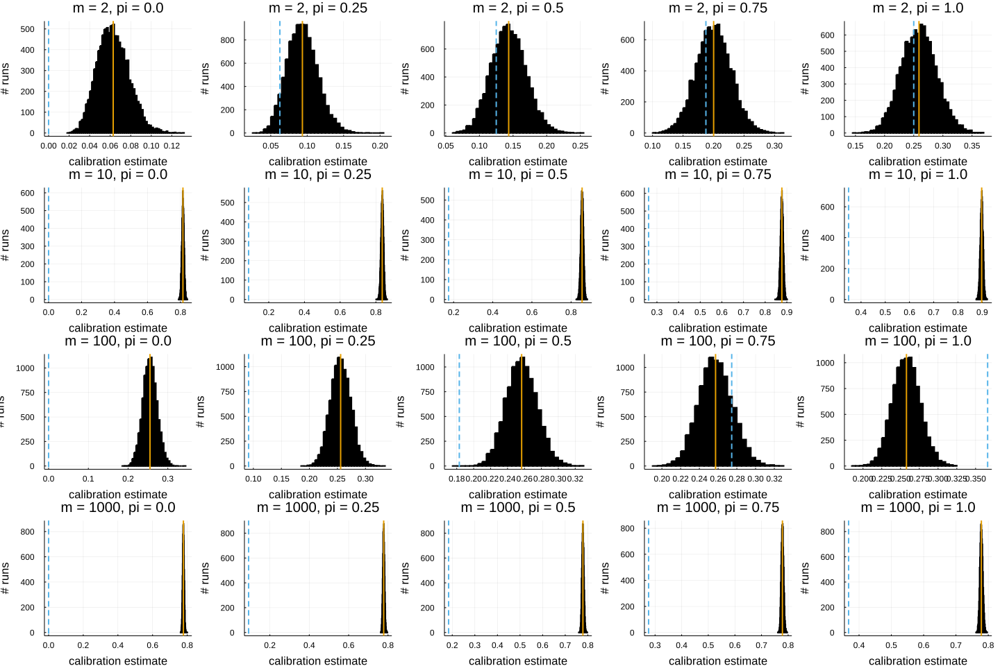

In [9]:
cegrid("ECE_uniform"; αᵢ = 1.0, only_firstclass = false)

#### Non-uniform predictions and uniform labels

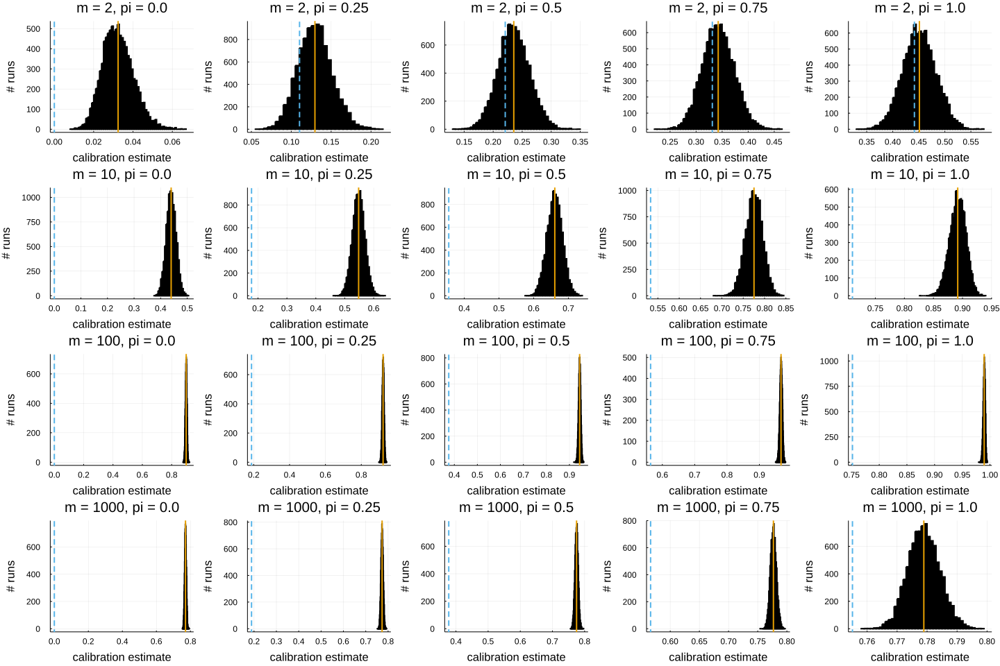

In [10]:
cegrid("ECE_uniform"; αᵢ = 0.1, only_firstclass = false)

#### Uniform predictions and non-uniform labels

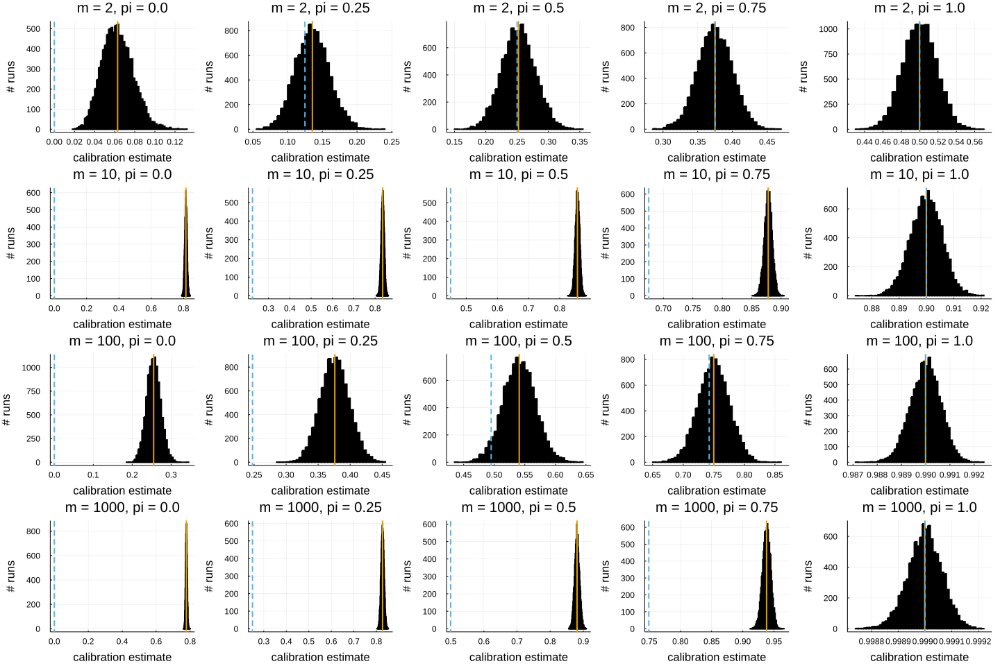

In [11]:
cegrid("ECE_uniform"; αᵢ = 1.0, only_firstclass = true)

#### Non-uniform predictions and non-uniform labels

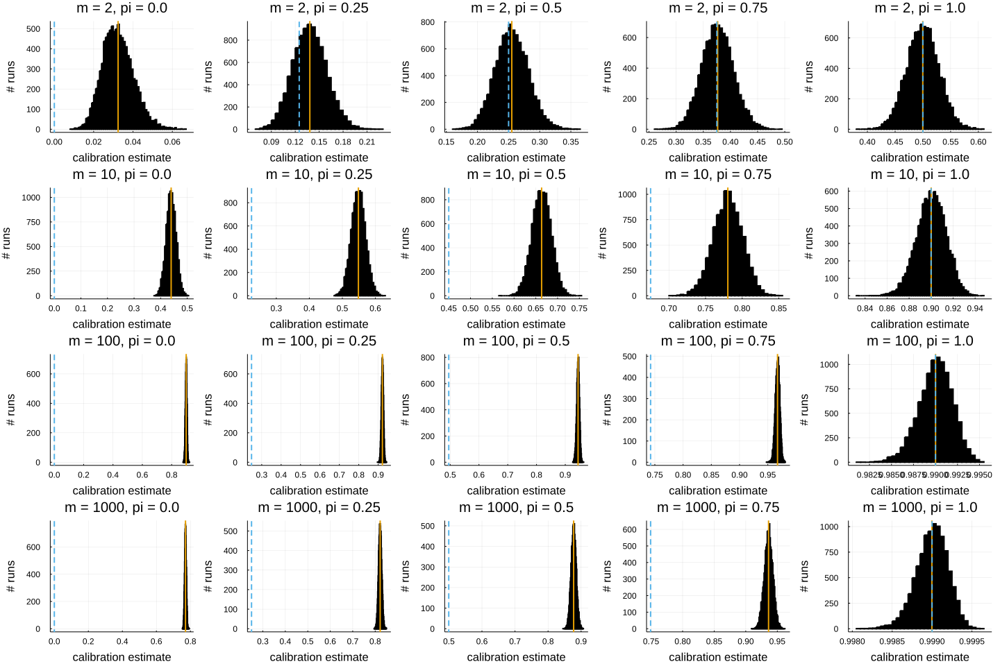

In [12]:
cegrid("ECE_uniform"; αᵢ = 0.1, only_firstclass = true)

### Non-uniform binning

We repeat our experiments with a different data-dependent binning scheme. This
time the bins will be computed dynamically by splitting the predictions at the
median of the classes with the highest variance, as long as the number of bins
does not exceed a given threshold and the number of samples per bin is above
a certain lower bound. In our experiments we do not impose any restriction on
the number of bins but only force the number of samples in each bin to be
greater or equal than 5.

In [13]:
perform("ECE_dynamic") do model
    ECE(MedianVarianceBinning(5))
end

┌ Info: skipping experiment ECE_dynamic: /home/davwi492/Projects/julia/CalibrationPaper/experiments/notebooks/../data/errors/ECE_dynamic.csv exists
└ @ Main In[6]:8


#### Uniform predictions and uniform labels

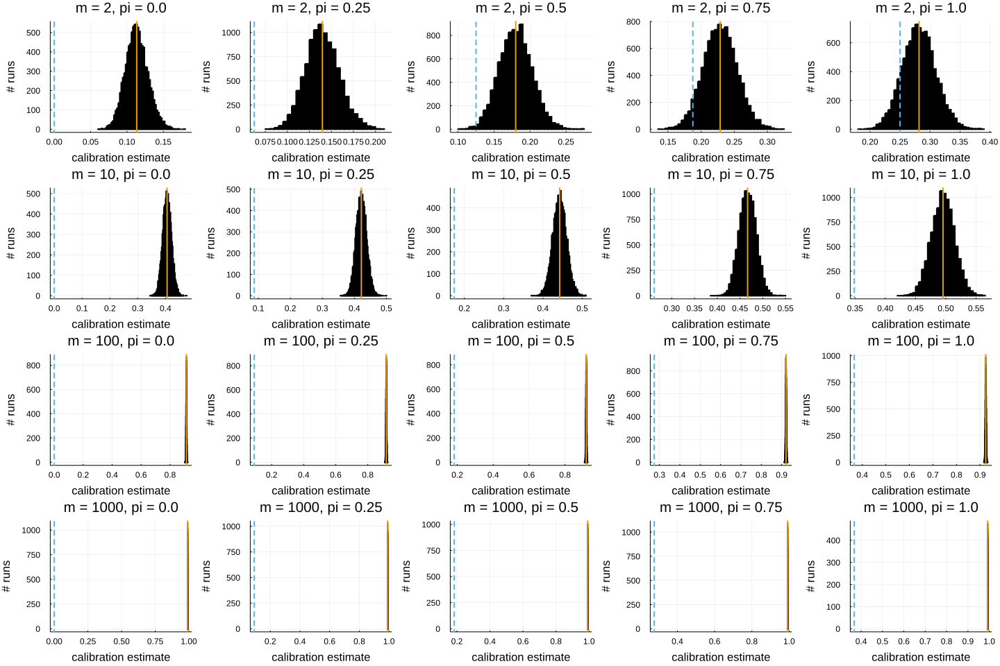

In [14]:
cegrid("ECE_dynamic"; αᵢ = 1.0, only_firstclass = false)

#### Non-uniform predictions and uniform labels

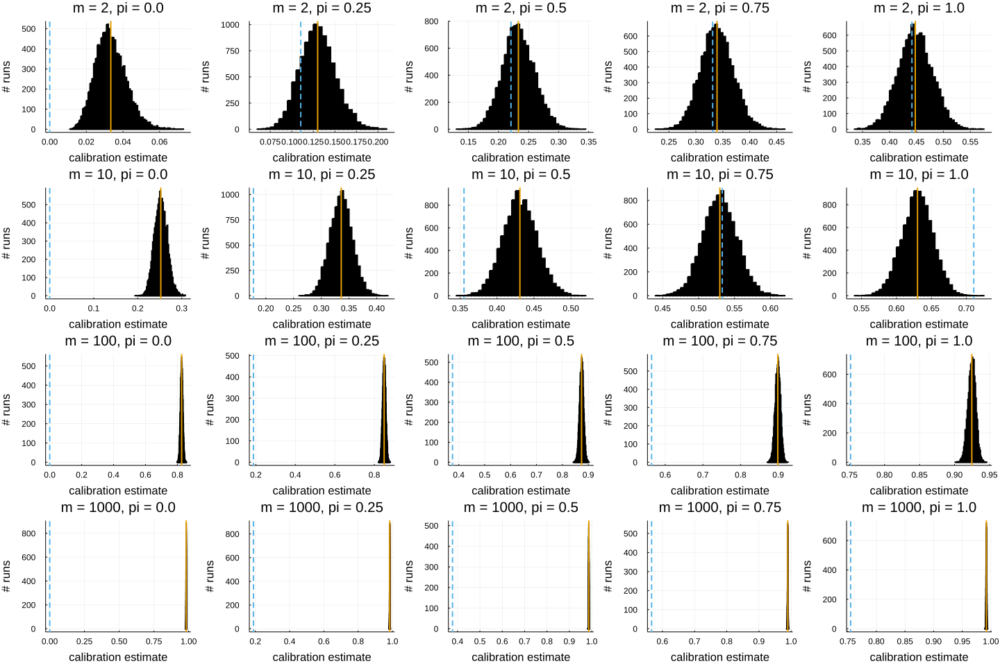

In [15]:
cegrid("ECE_dynamic"; αᵢ = 0.1, only_firstclass = false)

#### Uniform predictions and non-uniform labels

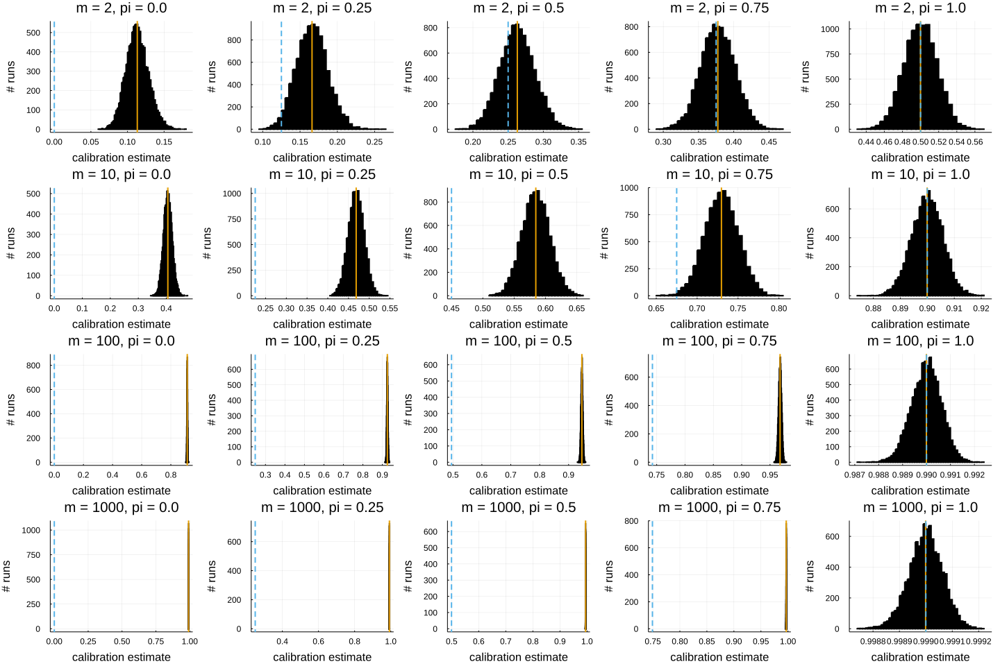

In [16]:
cegrid("ECE_dynamic"; αᵢ = 1.0, only_firstclass = true)

#### Non-uniform predictions and non-uniform labels

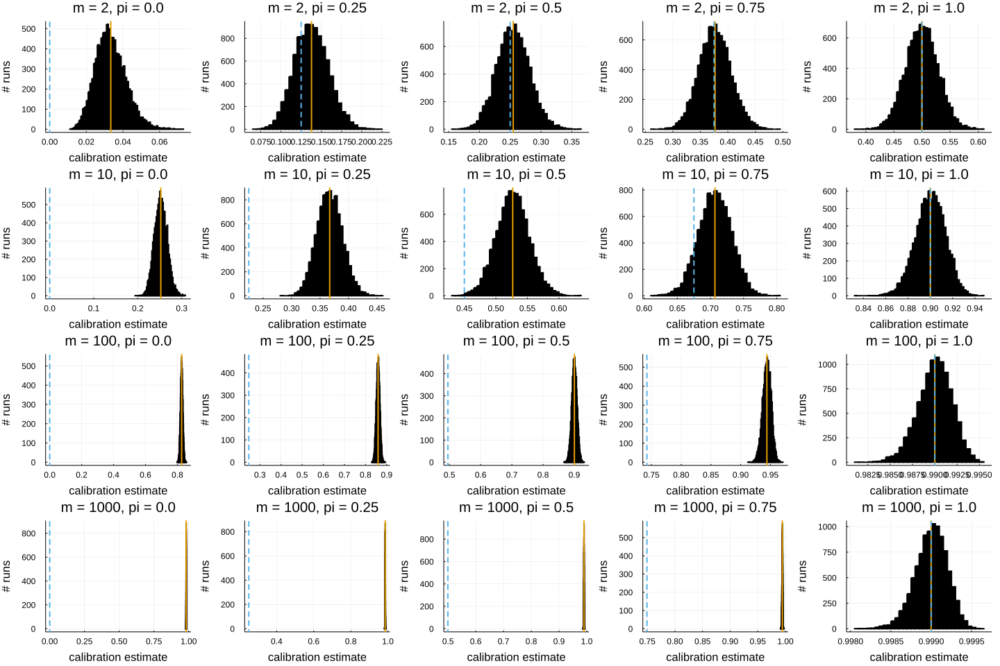

In [17]:
cegrid("ECE_dynamic"; αᵢ = 0.1, only_firstclass = true)

## Unbiased quadratic estimator of the squared kernel calibration error

### Median heuristic

First we try the median heuristic.

In [18]:
perform("SKCEuq_median") do model
    x -> QuadraticUnbiasedSKCE(median_TV_kernel(x))
end

┌ Info: skipping experiment SKCEuq_median: /home/davwi492/Projects/julia/CalibrationPaper/experiments/notebooks/../data/errors/SKCEuq_median.csv exists
└ @ Main In[6]:8


#### Uniform predictions and uniform labels

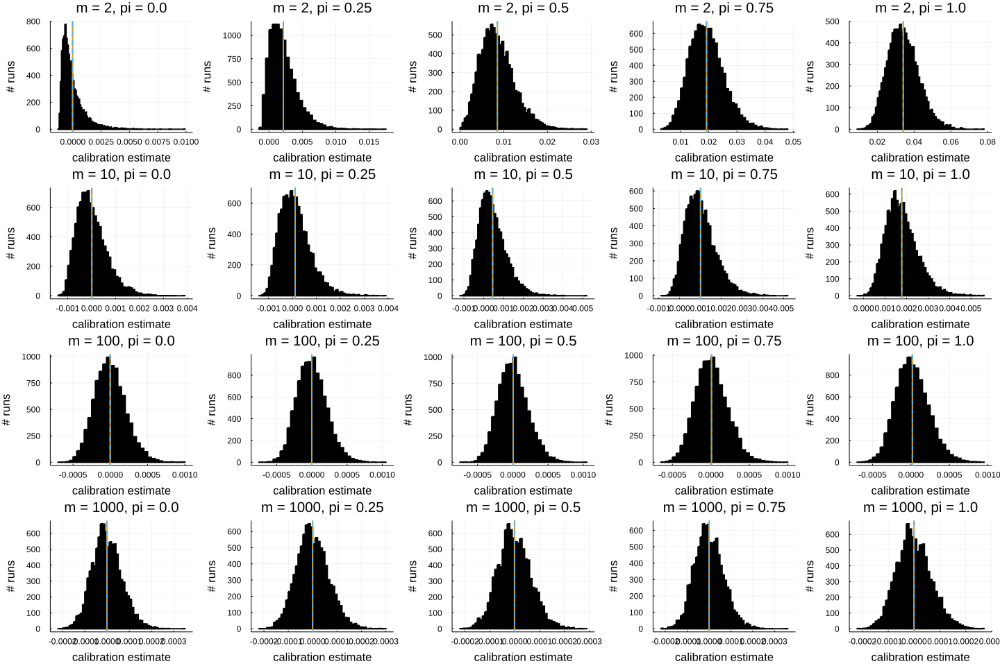

In [19]:
cegrid("SKCEuq_median"; αᵢ = 1.0, only_firstclass = false)

#### Non-uniform predictions and uniform labels

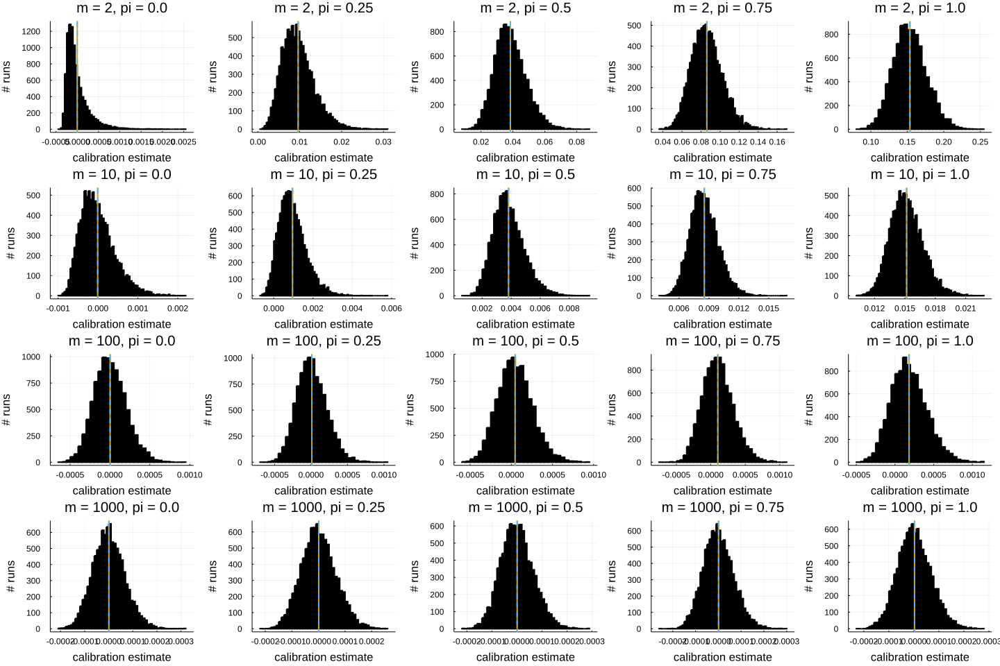

In [20]:
cegrid("SKCEuq_median"; αᵢ = 0.1, only_firstclass = false)

#### Uniform predictions and non-uniform labels

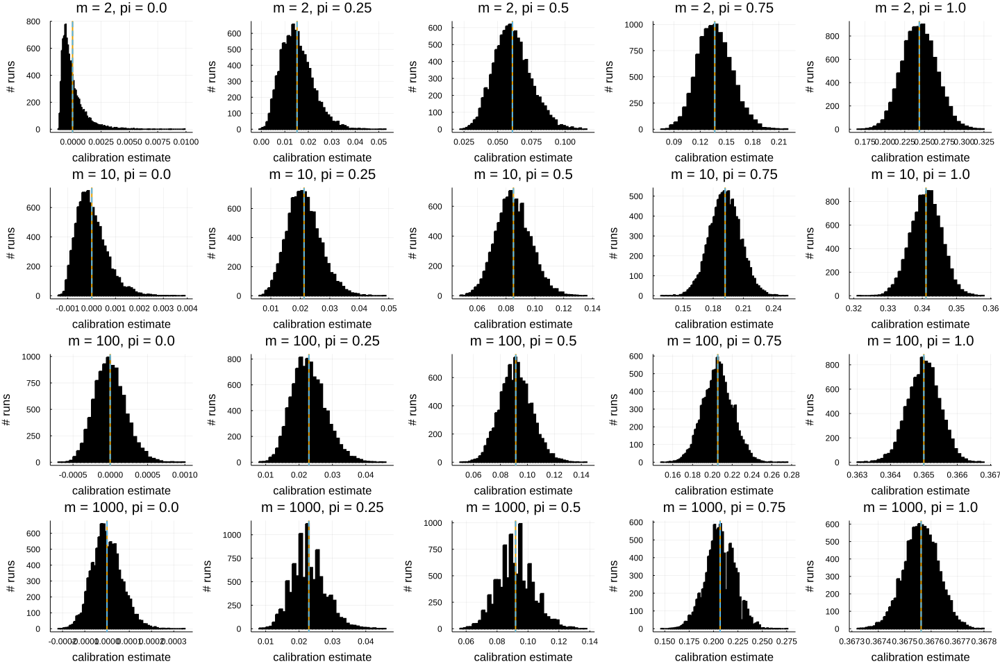

In [21]:
cegrid("SKCEuq_median"; αᵢ = 1.0, only_firstclass = true)

#### Non-uniform predictions and non-uniform labels

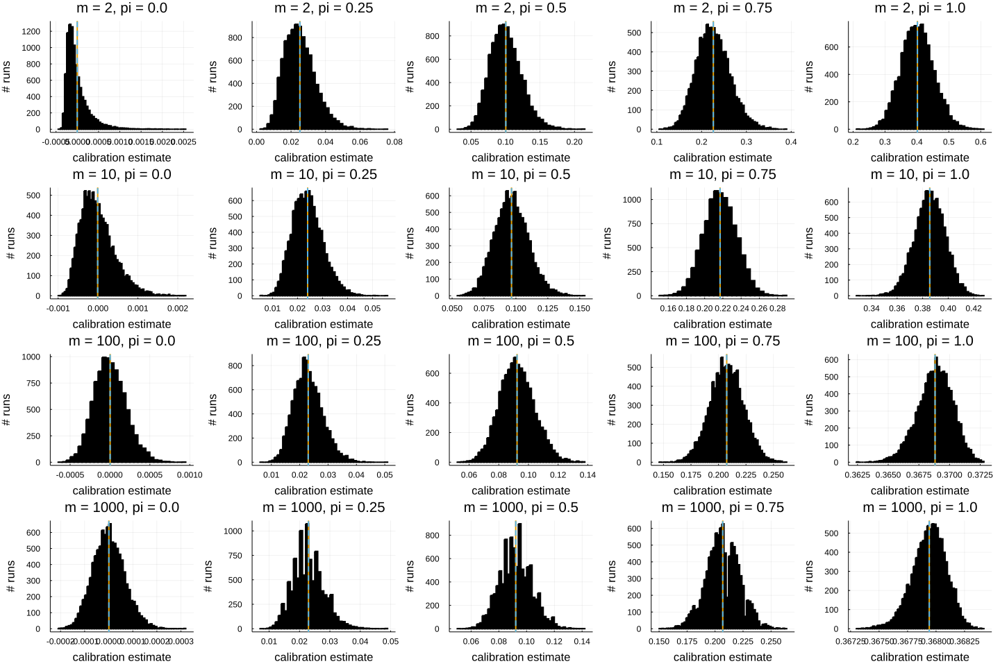

In [22]:
cegrid("SKCEuq_median"; αᵢ = 0.1, only_firstclass = true)

### Mean distance

We repeat the simulations with the mean total variation distance as bandwidth.

In [23]:
perform("SKCEuq_mean") do model
    QuadraticUnbiasedSKCE(mean_TV_kernel(model))
end

┌ Info: skipping experiment SKCEuq_mean: /home/davwi492/Projects/julia/CalibrationPaper/experiments/notebooks/../data/errors/SKCEuq_mean.csv exists
└ @ Main In[6]:8


#### Uniform predictions and uniform labels

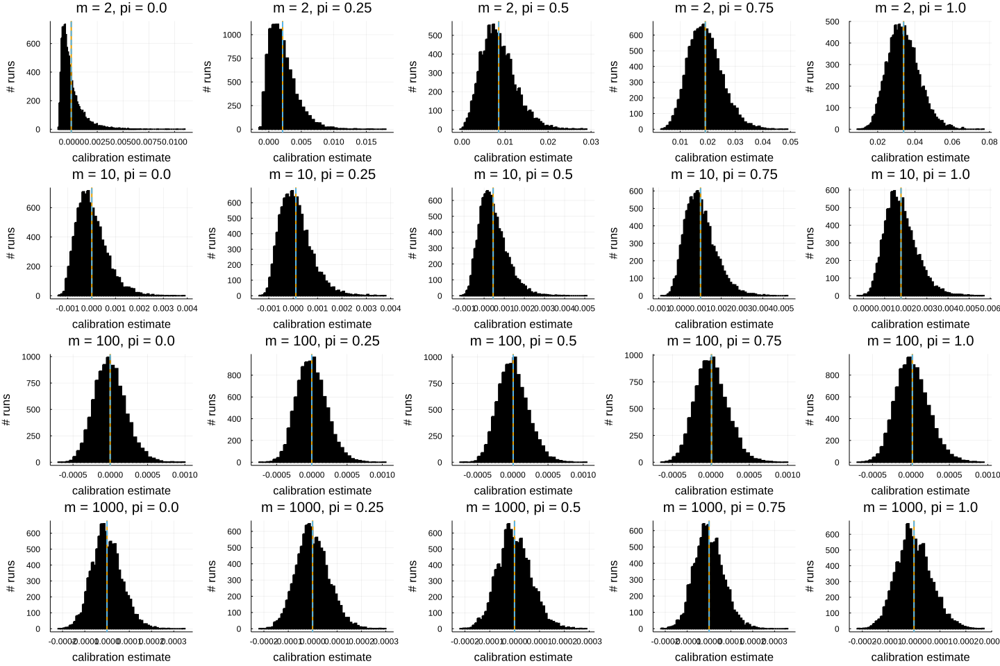

In [24]:
cegrid("SKCEuq_mean"; αᵢ = 1.0, only_firstclass = false)

#### Non-uniform predictions and uniform labels

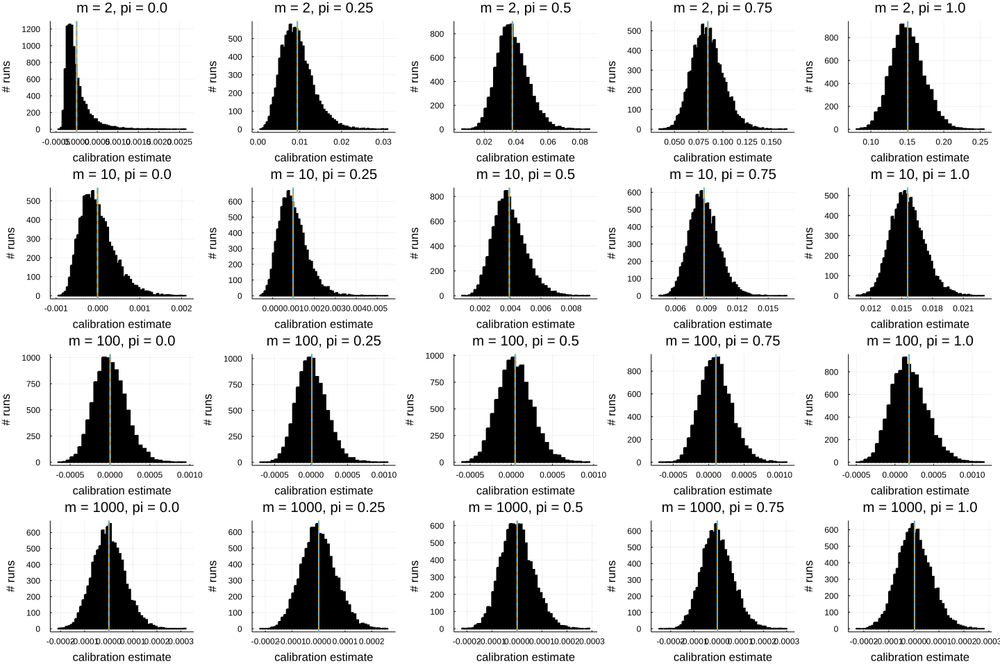

In [25]:
cegrid("SKCEuq_mean"; αᵢ = 0.1, only_firstclass = false)

#### Uniform predictions and non-uniform labels

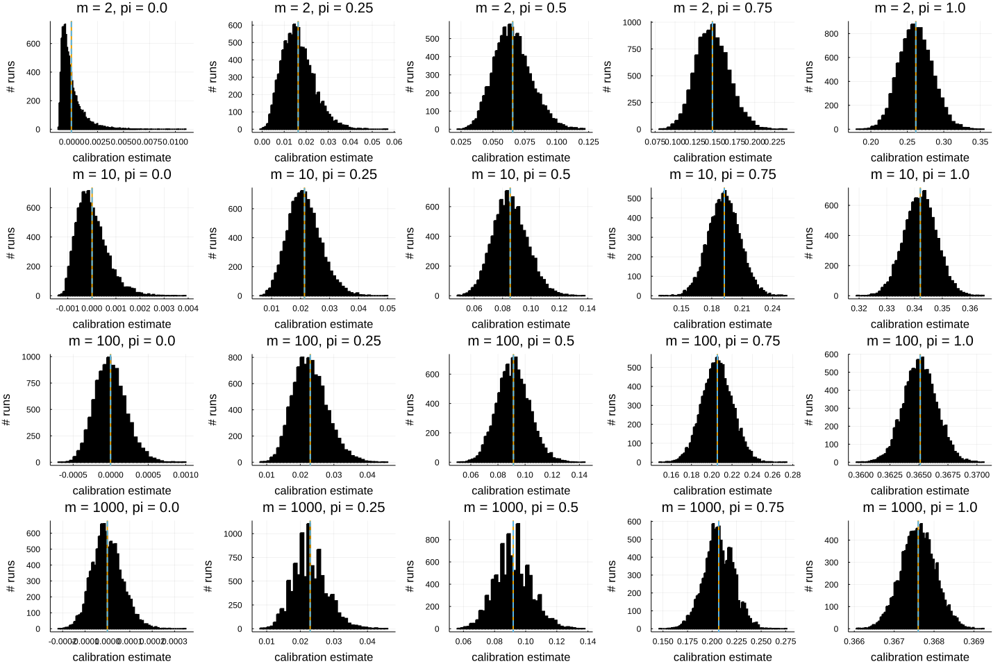

In [26]:
cegrid("SKCEuq_mean"; αᵢ = 1.0, only_firstclass = true)

#### Non-uniform predictions and non-uniform labels

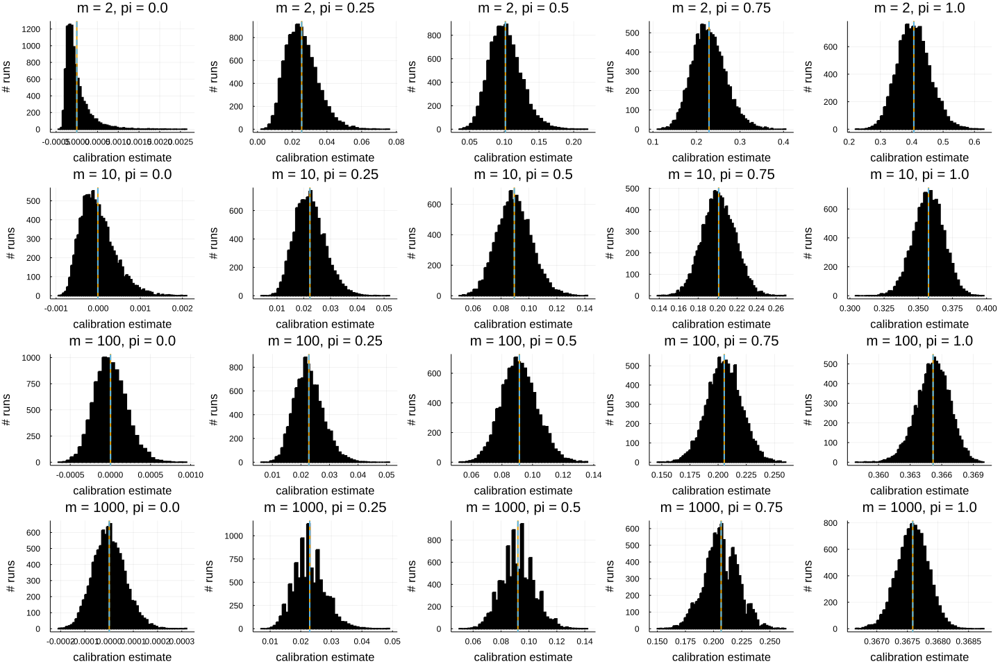

In [27]:
cegrid("SKCEuq_mean"; αᵢ = 0.1, only_firstclass = true)

## Unbiased linear estimator of the squared kernel calibration error

### Median heuristic

First we try the median heuristic. Again, we investigate uniform distributions
with different amounts of classes.

In [28]:
perform("SKCEul_median") do model
    x -> LinearUnbiasedSKCE(median_TV_kernel(x))
end

┌ Info: skipping experiment SKCEul_median: /home/davwi492/Projects/julia/CalibrationPaper/experiments/notebooks/../data/errors/SKCEul_median.csv exists
└ @ Main In[6]:8


#### Uniform predictions and uniform labels

In [29]:
cegrid("SKCEul_median"; αᵢ = 1.0, only_firstclass = false)

#### Non-uniform predictions and uniform labels

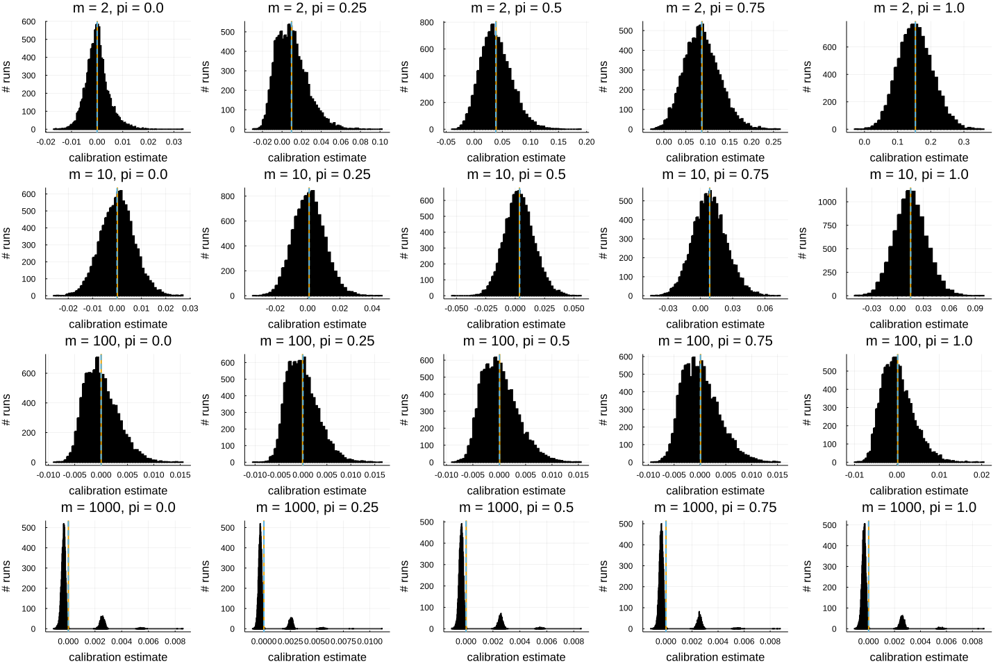

In [30]:
cegrid("SKCEul_median"; αᵢ = 0.1, only_firstclass = false)

#### Uniform predictions and non-uniform labels

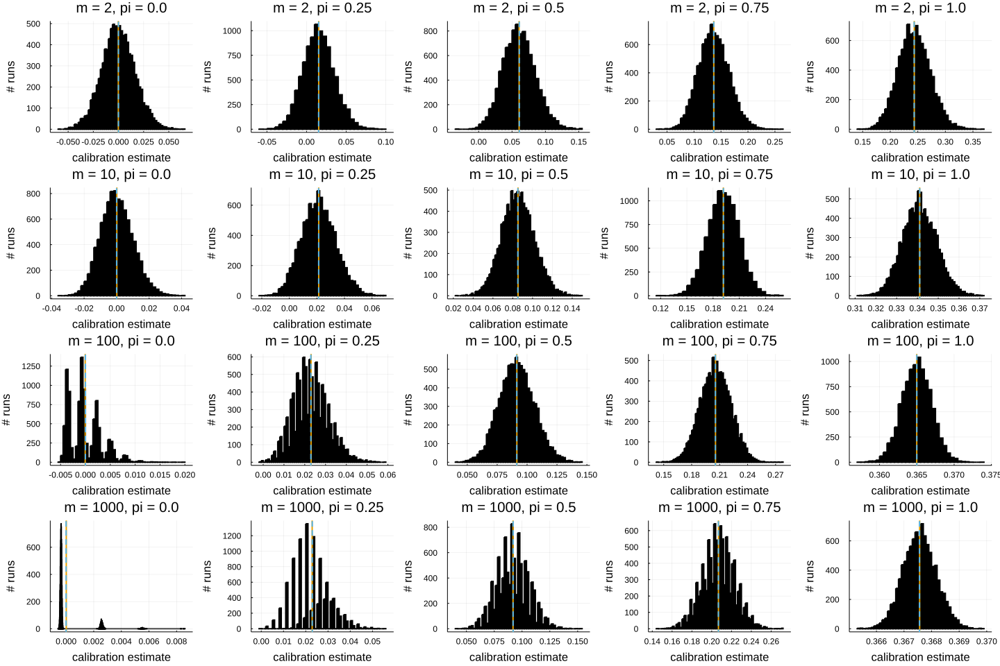

In [31]:
cegrid("SKCEul_median"; αᵢ = 1.0, only_firstclass = true)

#### Non-uniform predictions and non-uniform labels

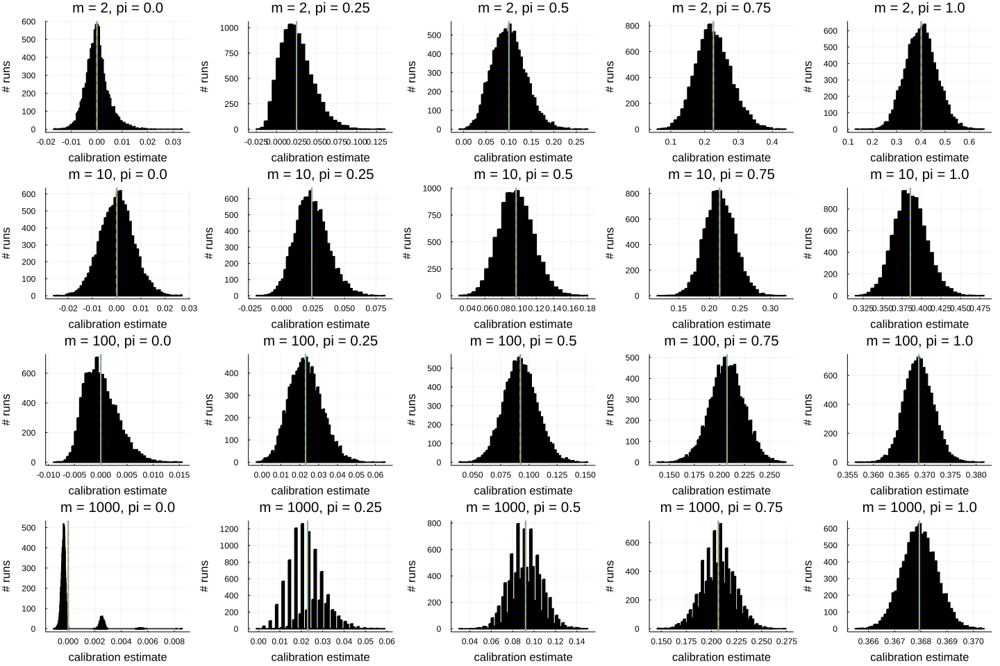

In [32]:
cegrid("SKCEul_median"; αᵢ = 0.1, only_firstclass = true)

### Mean distance

We repeat the simulations with the mean total variation distance as bandwidth.

In [33]:
perform("SKCEul_mean") do model
    LinearUnbiasedSKCE(mean_TV_kernel(model))
end

┌ Info: skipping experiment SKCEul_mean: /home/davwi492/Projects/julia/CalibrationPaper/experiments/notebooks/../data/errors/SKCEul_mean.csv exists
└ @ Main In[6]:8


#### Uniform predictions and uniform labels

In [34]:
cegrid("SKCEul_mean"; αᵢ = 1.0, only_firstclass = false)

#### Non-uniform predictions and uniform labels

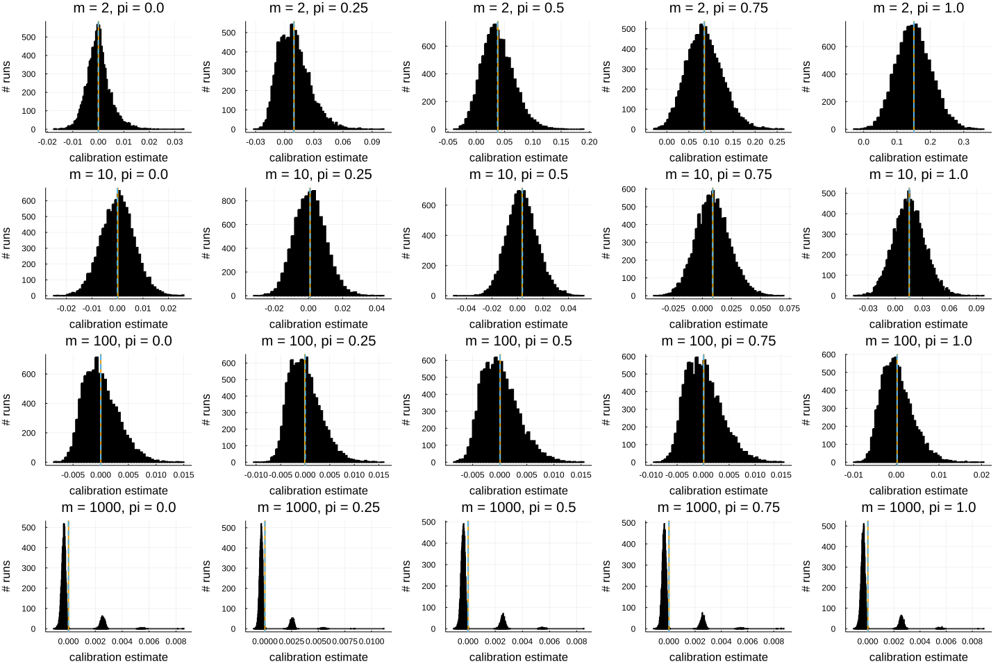

In [35]:
cegrid("SKCEul_mean"; αᵢ = 0.1, only_firstclass = false)

#### Uniform predictions and non-uniform labels

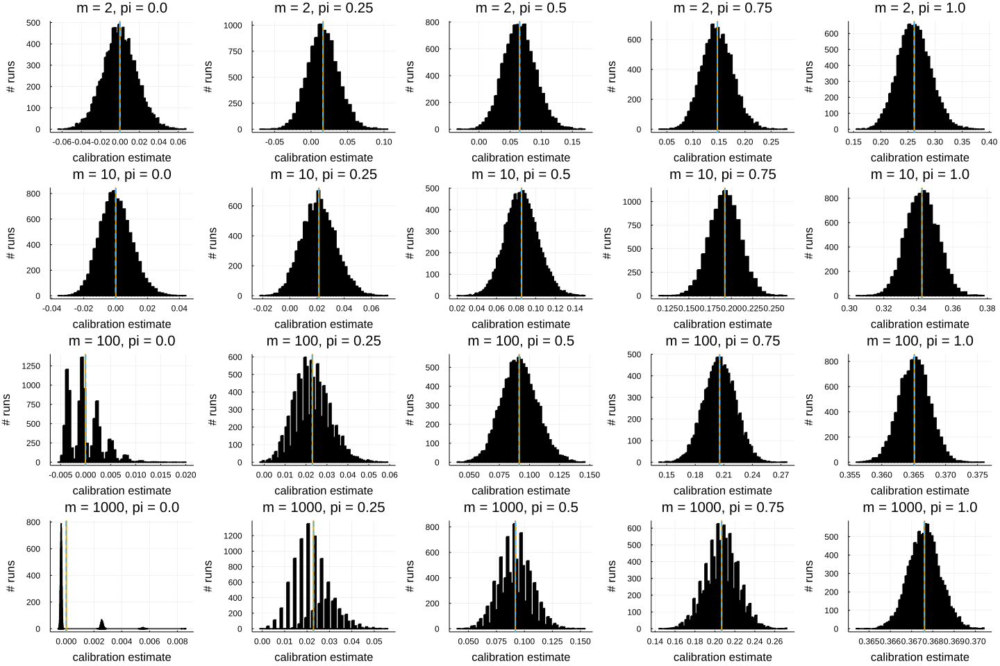

In [36]:
cegrid("SKCEul_mean"; αᵢ = 1.0, only_firstclass = true)

#### Non-uniform predictions and non-uniform labels

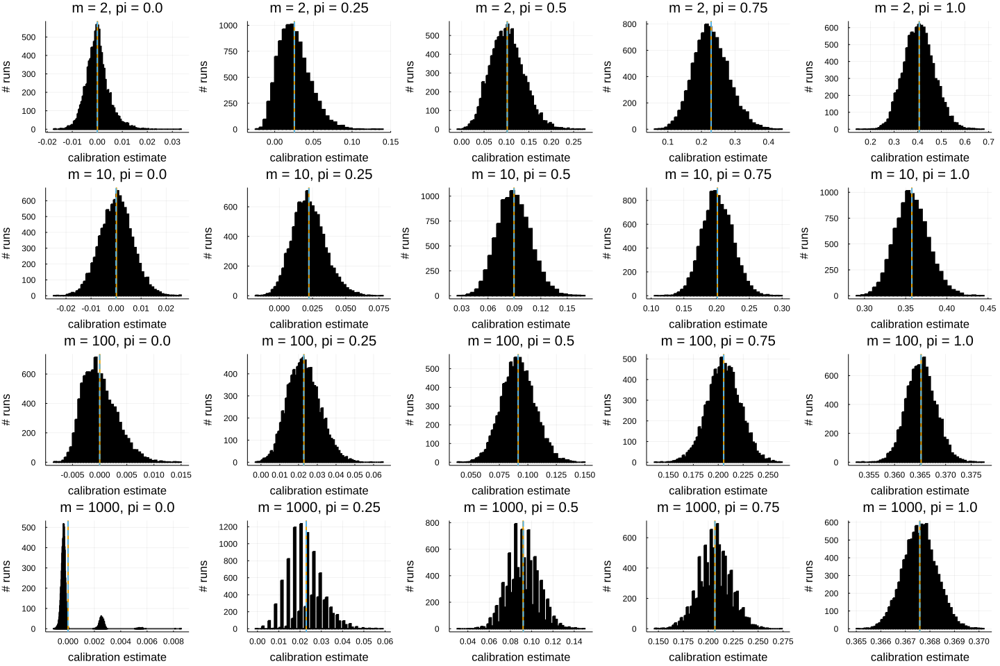

In [37]:
cegrid("SKCEul_mean"; αᵢ = 0.1, only_firstclass = true)

## Biased estimator of the squared kernel calibration error

### Median heuristic

First we try the median heuristic.

In [38]:
perform("SKCEb_median") do model
    x -> BiasedSKCE(median_TV_kernel(x))
end

┌ Info: skipping experiment SKCEb_median: /home/davwi492/Projects/julia/CalibrationPaper/experiments/notebooks/../data/errors/SKCEb_median.csv exists
└ @ Main In[6]:8


#### Uniform predictions and uniform labels

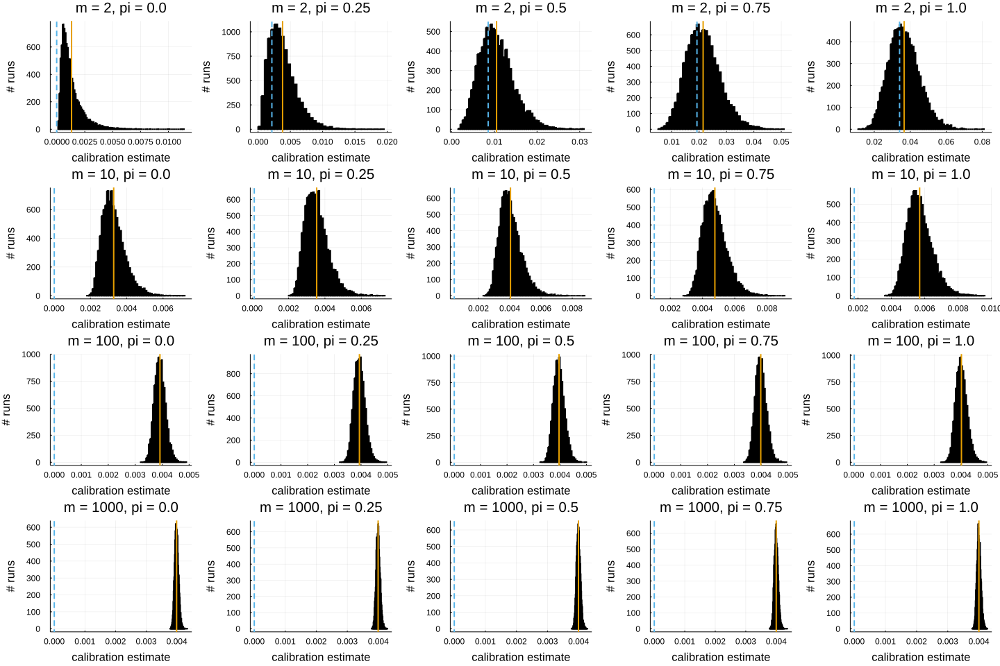

In [39]:
cegrid("SKCEb_median"; αᵢ = 1.0, only_firstclass = false)

#### Non-uniform predictions and uniform labels

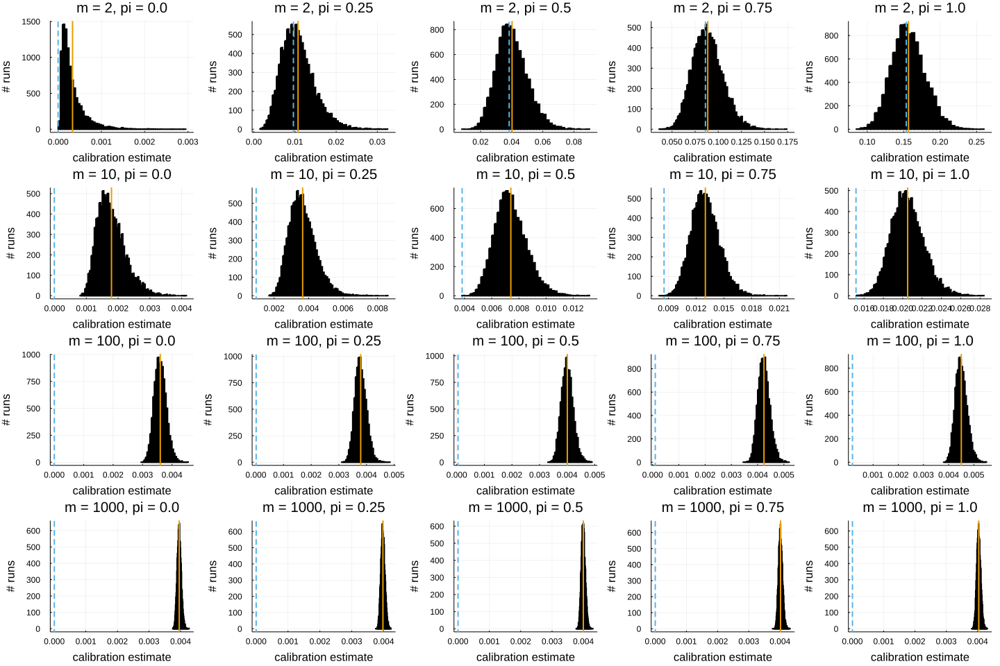

In [40]:
cegrid("SKCEb_median"; αᵢ = 0.1, only_firstclass = false)

#### Uniform predictions and non-uniform labels

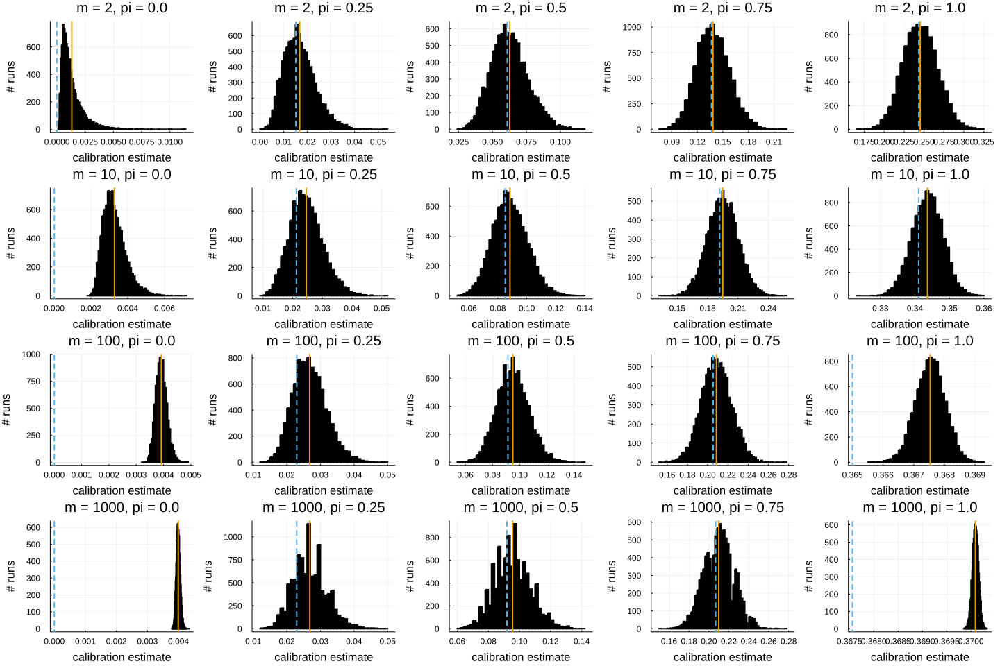

In [41]:
cegrid("SKCEb_median"; αᵢ = 1.0, only_firstclass = true)

#### Non-uniform predictions and non-uniform labels

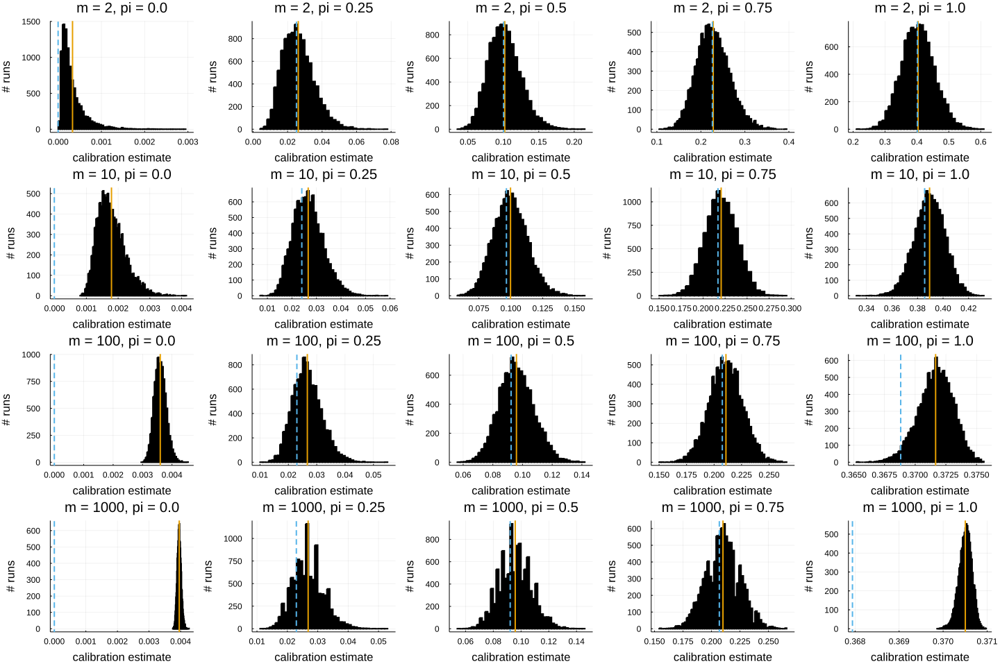

In [42]:
cegrid("SKCEb_median"; αᵢ = 0.1, only_firstclass = true)

### Mean distance

We repeat the simulations with the mean total variation distance as bandwidth.

In [43]:
perform("SKCEb_mean") do model
    BiasedSKCE(mean_TV_kernel(model))
end

┌ Info: skipping experiment SKCEb_mean: /home/davwi492/Projects/julia/CalibrationPaper/experiments/notebooks/../data/errors/SKCEb_mean.csv exists
└ @ Main In[6]:8


#### Uniform predictions and uniform labels

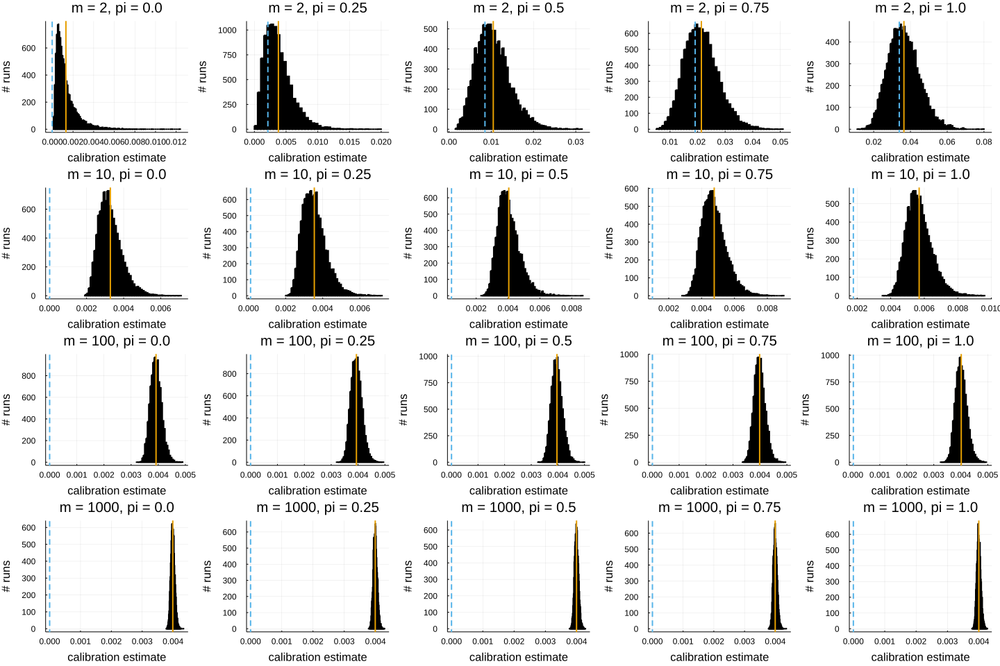

In [44]:
cegrid("SKCEb_mean"; αᵢ = 1.0, only_firstclass = false)

#### Non-uniform predictions and uniform labels

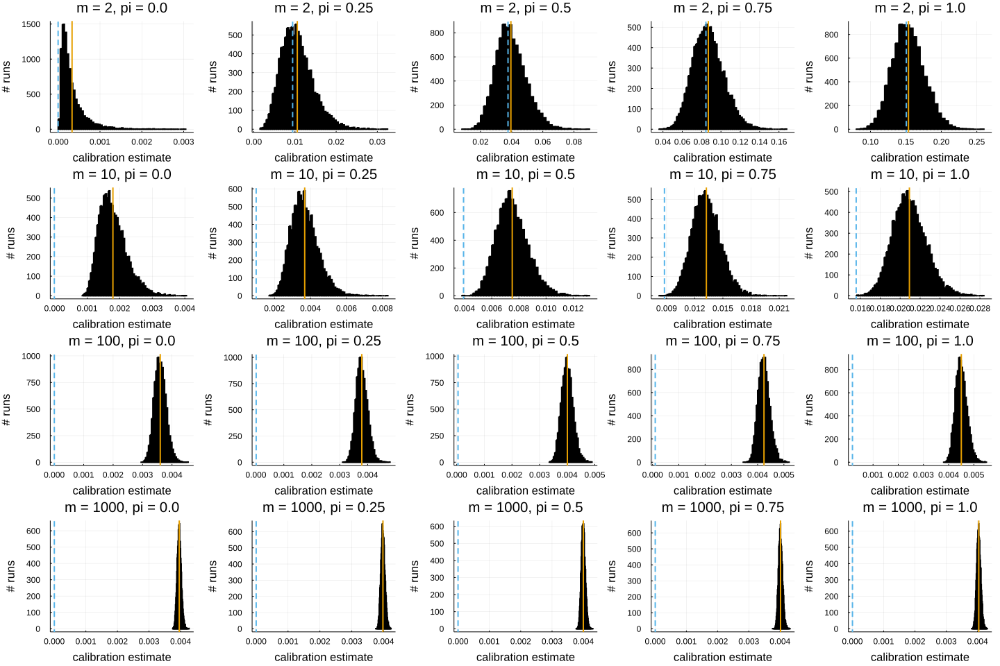

In [45]:
cegrid("SKCEb_mean"; αᵢ = 0.1, only_firstclass = false)

#### Uniform predictions and non-uniform labels

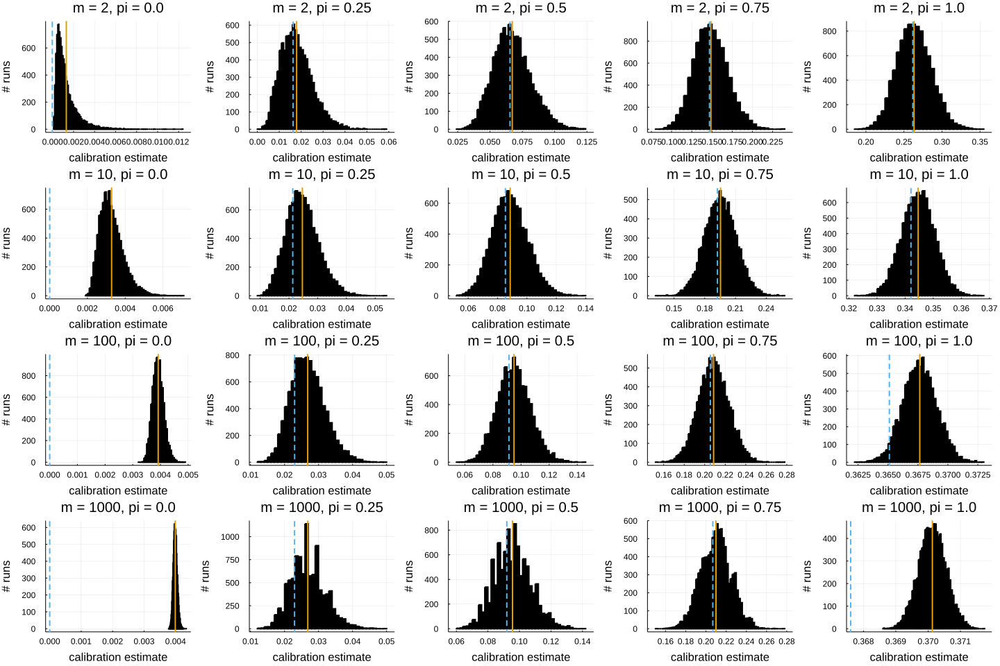

In [46]:
cegrid("SKCEb_mean"; αᵢ = 1.0, only_firstclass = true)

#### Non-uniform predictions and non-uniform labels

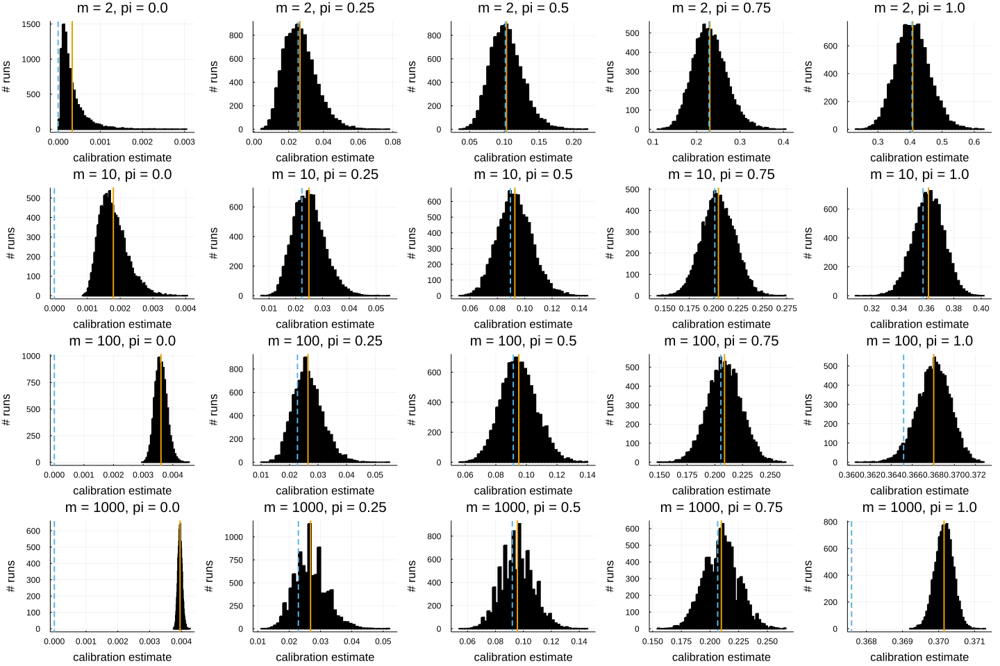

In [47]:
cegrid("SKCEb_mean"; αᵢ = 0.1, only_firstclass = true)